The dataset provided for this application is the UCI repository Bank Marketing Dataset. https://archive.ics.uci.edu/dataset/222/bank+marketing
The data is related with direct marketing campaigns of a Portuguese banking institution. The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, in order to access if the product (bank term deposit) would be ('yes') or not ('no') subscribed. 

Classification Goal: Predict if a client would subscribe to a bank term deposit. That is, predict that y == 'yes'

Input variables:
   - 1 - age (numeric)
   - 2 - job : type of job (categorical: "admin.","unknown","unemployed","management","housemaid","entrepreneur","student",
                                       "blue-collar","self-employed","retired","technician","services") 
   - 3 - marital : marital status (categorical: "married","divorced","single"; note: "divorced" means divorced or widowed)
   - 4 - education (categorical: "unknown","secondary","primary","tertiary")
   - 5 - default: has credit in default? (binary: "yes","no")
   - 6 - balance: average yearly balance, in euros (numeric) 
   - 7 - housing: has housing loan? (binary: "yes","no")
   - 8 - loan: has personal loan? (binary: "yes","no")
   - 9 - contact: contact communication type (categorical: "unknown","telephone","cellular") 
  - 10 - day: last contact day of the month (numeric)
  - 11 - month: last contact month of year (categorical: "jan", "feb", "mar", ..., "nov", "dec")
  - 12 - duration: last contact duration, in seconds (numeric)
  - 13 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
  - 14 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)
  - 15 - previous: number of contacts performed before this campaign and for this client (numeric)
  - 16 - poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success")

Output variable (desired target):
  - 17 - y - has the client subscribed a term deposit? (binary: "yes","no")

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import calendar

from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score,accuracy_score,recall_score,RocCurveDisplay
from sklearn.metrics import roc_curve
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC, SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder, PolynomialFeatures
from sklearn.calibration import CalibratedClassifierCV
from ydata_profiling import ProfileReport

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
from ucimlrepo import fetch_ucirepo 
  
# fetch dataset 
bank_marketing = fetch_ucirepo(id=222) 

In [4]:
bank_marketing_df = bank_marketing.data.original

#### Data Profiling

In [5]:
#Use the ydata_profiling package. It has trouble with the Hboxmodel throwing the correlation matrix outside the planned area, but does a good job otherwise. 

profile = ProfileReport(bank_marketing_df, title="Bank Marketing Profiling")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data cleansing

#### Missing Values

- Drop "poutcome" because it has too many missing values. "contact" seems irrelevant, dropping this columns as well.
- Replace missing values in "job" and "education" with unknown

In [6]:
bank_marketing_df.drop(columns=["poutcome","contact"], inplace=True)
bank_marketing_df['job'].fillna("unknown", inplace=True)
bank_marketing_df['education'].fillna("unknown", inplace=True)

#### Transform the "job" feature

One Hot encoding will create 12 additional columns. To reduce the dimensions, I chose to combine job categories with similar distributions of the target variable.

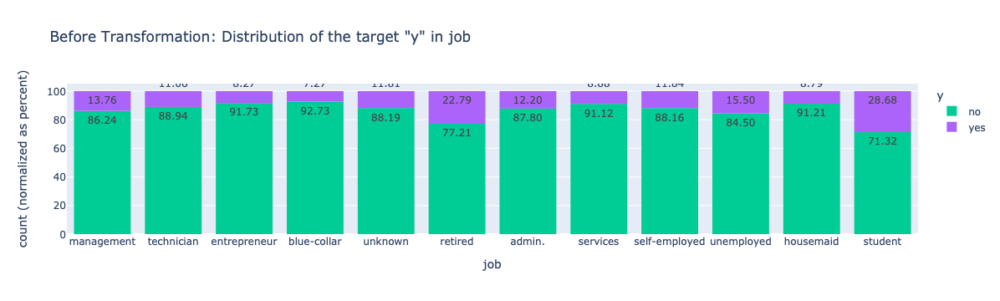

In [7]:
fig0 = px.histogram(bank_marketing_df,
                x="job", 
                color="y", 
                title=f'Before Transformation: Distribution of the target "y" in job', 
                text_auto=True, 
                color_discrete_map={'Rejected':'#FF7477','Accepted':'#BBF1C4'},
                barnorm="percent")
fig0.update_traces(texttemplate='%{y:.2f}')
fig0.show()

In [8]:
def is_member(value, iterable):
     for item in iterable:
         if value is item or value == item:
             return True
     return False

def job_categories(job):
    if is_member(job, ['retired','student']):
         return '70_pct'
    if is_member(job, ['management', 'technician','admin.','self-employed','unemployed', 'unknown']):
         return '80_pct'
    if is_member(job, ['entrepreneur','blue-collar','housemaid','services']):
         return '90_pct'
    if (job == 'unknown'):
        return job

bank_marketing_df['job_replaced'] = bank_marketing_df['job'].apply(job_categories)

In [9]:
bank_marketing_df['job_replaced'].value_counts()

job_replaced
80_pct    25396
90_pct    16613
70_pct     3202
Name: count, dtype: int64

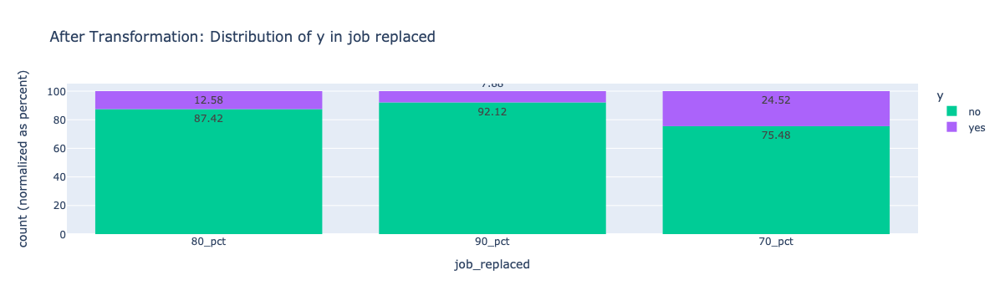

In [10]:
fig1 = px.histogram(bank_marketing_df,
                x="job_replaced", 
                color="y", 
                title=f'After Transformation: Distribution of y in job replaced',
                color_discrete_map={'Rejected':'#FF7477','Accepted':'#BBF1C4'},
                text_auto=True, barnorm="percent")
fig1.update_traces(texttemplate='%{y:.2f}')
fig1.show()

Drop the job column

In [11]:
bank_marketing_df.drop(columns=['job'], inplace=True)

#### Transform the "month" feature

To reduce the dimensions, I chose to transform the month to sin and cosine representations of the same

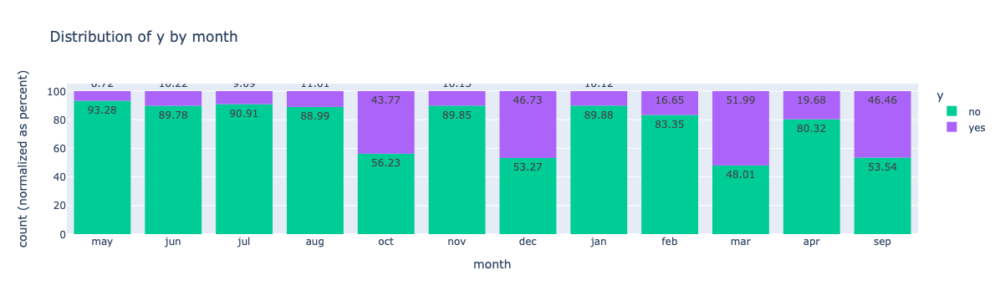

In [12]:
fig2 = px.histogram(bank_marketing_df,
                x="month", 
                color="y", 
                title=f'Distribution of y by month', 
                color_discrete_map={'Rejected':'#FF7477','Accepted':'#BBF1C4'},
                text_auto=True, 
                barnorm="percent")
fig2.update_traces(texttemplate='%{y:.2f}')
fig2.show()

In [13]:
month_dict = {month.lower(): index for index, month in enumerate(calendar.month_abbr) if month}

def month_to_num(month):
    return month_dict[month]


In [14]:
bank_marketing_df["month_num"] = bank_marketing_df["month"].apply(month_to_num)
bank_marketing_df['month_sin'] = np.sin(2 * np.pi * bank_marketing_df['month_num']/12.0)
bank_marketing_df['month_cos'] = np.cos(2 * np.pi * bank_marketing_df['month_num']/12.0)

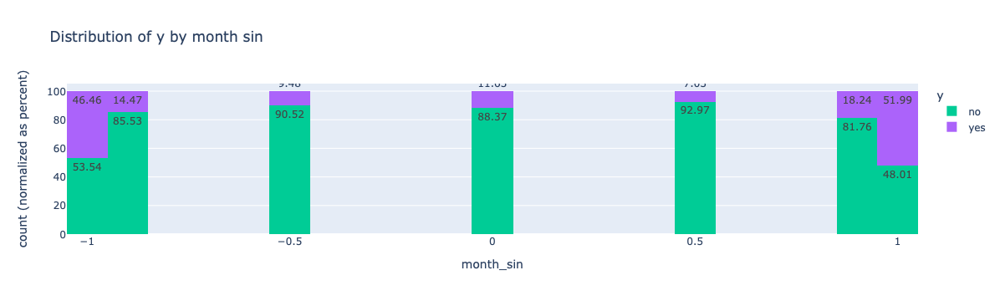

In [15]:
fig2_1 = px.histogram(bank_marketing_df,
                x="month_sin", 
                color="y", 
                title=f'Distribution of y by month sin', 
                color_discrete_map={'Rejected':'#FF7477','Accepted':'#BBF1C4'},
                text_auto=True, 
                barnorm="percent")
fig2_1.update_traces(texttemplate='%{y:.2f}')
fig2_1.show()

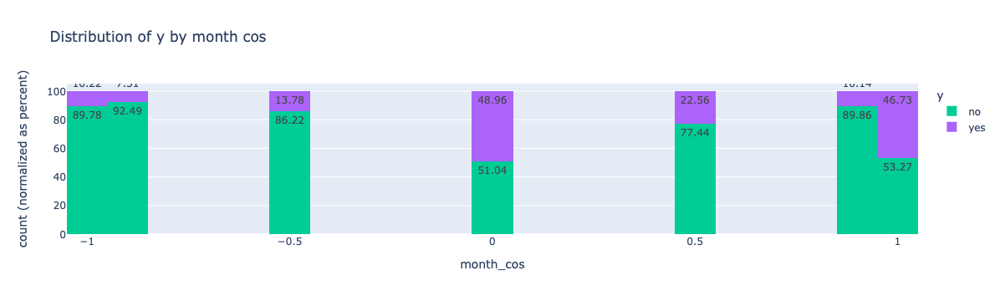

In [16]:
fig2_2 = px.histogram(bank_marketing_df,
                x="month_cos", 
                color="y", 
                title=f'Distribution of y by month cos', 
                color_discrete_map={'Rejected':'#FF7477','Accepted':'#BBF1C4'},
                text_auto=True, 
                barnorm="percent")
fig2_2.update_traces(texttemplate='%{y:.2f}')
fig2_2.show()

In [17]:
bank_marketing_df.drop(columns=['month_num','month'],inplace=True)

### Create Test Train Split

In [18]:
# replacing yes and no from y column by 1 and 0 to convert categorical feature to numerical feature
bank_marketing_df['y'].replace(to_replace='yes', value=1, inplace=True)
bank_marketing_df['y'].replace(to_replace='no',  value=0, inplace=True)

In [19]:
X = bank_marketing_df.drop(columns='y') 
y = bank_marketing_df['y']

In [20]:
random_state = 42
cv = 5

#30% split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=random_state)


In [21]:
# determine categorical and numerical features
numerical_columns = bank_marketing_df.select_dtypes(include=['int64', 'float64']).columns
categorical_columns = bank_marketing_df.select_dtypes(include=['object', 'bool']).columns
print(numerical_columns)
print(categorical_columns)

Index(['age', 'balance', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'y', 'month_sin', 'month_cos'],
      dtype='object')
Index(['marital', 'education', 'default', 'housing', 'loan', 'job_replaced'], dtype='object')


## Comparison of Learning algorithms

In [22]:
transformer = make_column_transformer(
    (StandardScaler(), ['age', 'balance','duration', 'campaign', 'pdays', 'previous']),
    (OrdinalEncoder(), ['job_replaced', 'marital', 'education']),
    (OneHotEncoder(drop='if_binary'), ['default', 'housing', 'loan']),
    remainder='passthrough')

#### Logistic Regression

In [23]:
lr = Pipeline([
    ('transform', transformer),
    ('lrr',LogisticRegression(random_state=random_state))])
params_lr = {
    'lrr__solver': ['liblinear'],
    'lrr__penalty': ['l1','l2'],
    'lrr__C': np.logspace(0.01, 0.1, 1, 2, 10),
    }
lr_gridcv = GridSearchCV(estimator=lr, param_grid=params_lr, scoring='accuracy', cv=cv, return_train_score=True)
lr_gridcv.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('transform',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('standardscaler',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'balance',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinalencoder',
                                                                         OrdinalEncoder(),
                                                                         ['job_replaced',
                                                                          'marital',
                                                                          'education']),
                                                                        ('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['default',
                                                                          'housing',
                                                                          'loan'])])),
                                       ('lrr',
                                        LogisticRegression(random_state=42))]),
             param_grid={'lrr__C': array([1.02329299]),
                         'lrr__penalty': ['l1', 'l2'],
                         'lrr__solver': ['liblinear']},
             return_train_score=True, scoring='accuracy')

### Examine the feature importance for logistic regression

Text(0.5, 1.0, 'Feature Importance of Logistic Regression Classifier')

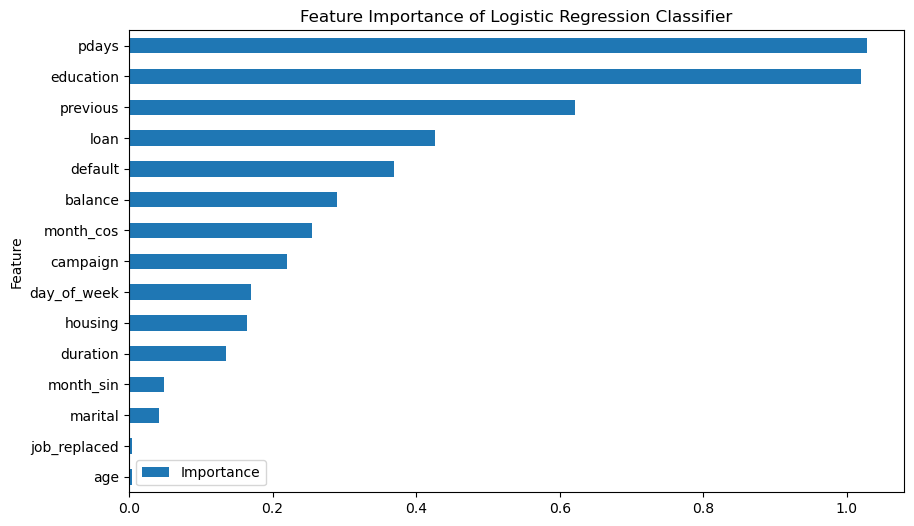

In [52]:
coefficients = lr_gridcv.best_estimator_.named_steps.lrr.coef_[0]

feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))
plt.title("Feature Importance of Logistic Regression Classifier")

The two important features are pdays and education.

[[11721   245]
 [ 1272   326]]
              precision    recall  f1-score   support

           0       0.90      0.98      0.94     11966
           1       0.57      0.20      0.30      1598

    accuracy                           0.89     13564
   macro avg       0.74      0.59      0.62     13564
weighted avg       0.86      0.89      0.86     13564

AUC score for Logistic Regression is  0.8697715073810507
Test Accuracy score for Logistic Regression is  0.8881598348569744
Train Accuracy score for Logistic Regression is  0.8910797231965115
Test Recall score for Logistic Regression is  0.20400500625782228
Train Recall score for Logistic Regression is  0.21159577350311568
Best parameters for Logistic Regression are  {'lrr__C': 1.023292992280754, 'lrr__penalty': 'l2', 'lrr__solver': 'liblinear'}


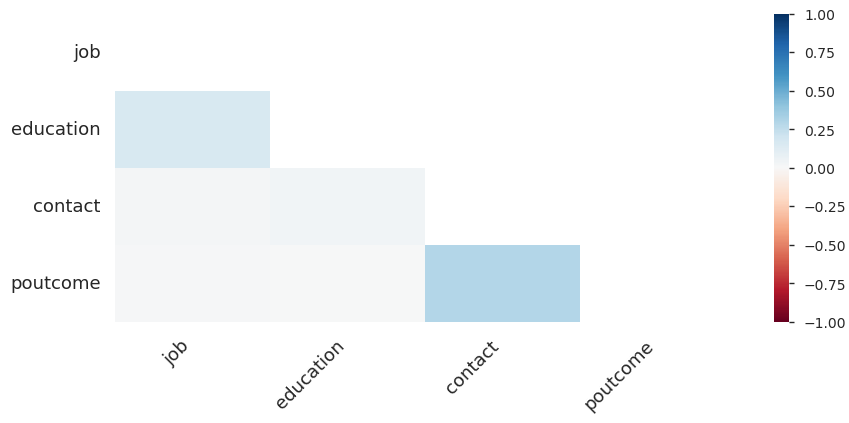

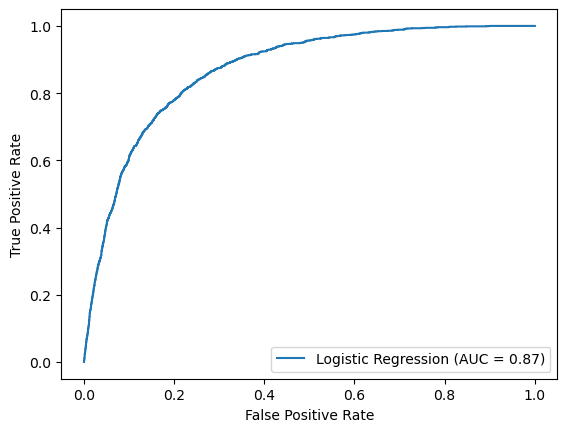

In [24]:
#matplotlib.use('tkagg')
%matplotlib inline
pred = lr_gridcv.predict(X_test)
predT = lr_gridcv.predict(X_train)

accLR = accuracy_score(y_test, pred)
accLR_train = accuracy_score(y_train, predT)
recallLR = recall_score(y_test, pred)

y_pred_prob = lr_gridcv.predict_proba(X_test)
aucScoreLR = roc_auc_score(y_test,  y_pred_prob[:,1])
fprLR, tprLR, thresholds = roc_curve(y_test, y_pred_prob[:,1] )

print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))
print("AUC score for Logistic Regression is ", aucScoreLR)
print("Test Accuracy score for Logistic Regression is ", accLR)
print("Train Accuracy score for Logistic Regression is ", accLR_train)
print("Test Recall score for Logistic Regression is ", recallLR)
print("Train Recall score for Logistic Regression is ", recall_score(y_train, predT))
print("Best parameters for Logistic Regression are ", lr_gridcv.best_params_)

display = RocCurveDisplay(fpr=fprLR, tpr=tprLR, roc_auc=aucScoreLR,
                                 estimator_name='Logistic Regression')
display.plot()
plt.show()

#### SVC

In [25]:
svc_linear = Pipeline([
    ('transform', transformer),
    ('svcc', LinearSVC(random_state=random_state, dual=False))])
params_svc_linear =[
    {'svcc__C':[1,10,100,1000]}]
svc_gridcv_linear = GridSearchCV(estimator=svc_linear, param_grid=params_svc_linear, scoring='accuracy', cv=cv, n_jobs=-1)
svc_gridcv_linear.fit(X_train,y_train)


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('transform',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('standardscaler',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'balance',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinalencoder',
                                                                         OrdinalEncoder(),
                                                                         ['job_replaced',
                                                                          'marital',
                                                                          'education']),
                                                                        ('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['default',
                                                                          'housing',
                                                                          'loan'])])),
                                       ('svcc',
                                        LinearSVC(dual=False,
                                                  random_state=42))]),
             n_jobs=-1, param_grid=[{'svcc__C': [1, 10, 100, 1000]}],
             scoring='accuracy')

Text(0.5, 1.0, 'Feature Importance of Linear SVM Classifier')

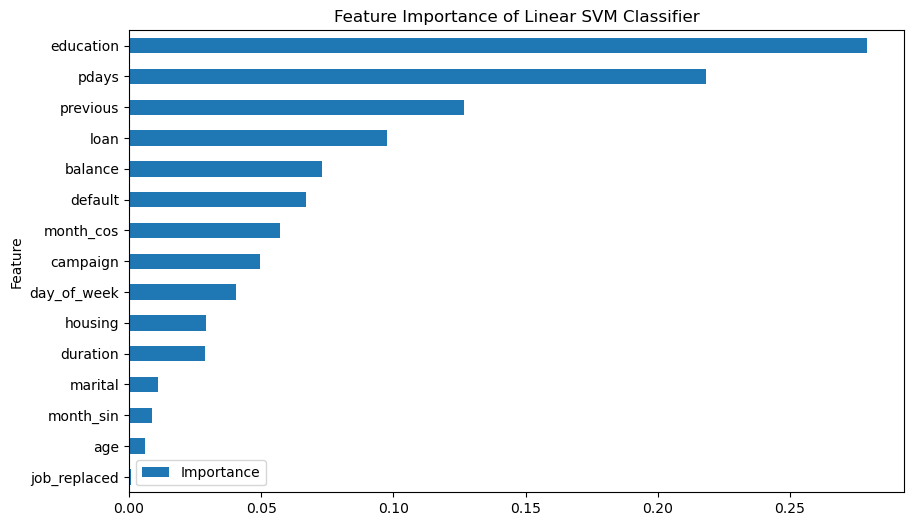

In [54]:
svm_coefficients = svc_gridcv_linear.best_estimator_.named_steps.svcc.coef_[0]

feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(svm_coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))
plt.title("Feature Importance of Linear SVM Classifier")

[[11822   144]
 [ 1378   220]]
              precision    recall  f1-score   support

           0       0.90      0.99      0.94     11966
           1       0.60      0.14      0.22      1598

    accuracy                           0.89     13564
   macro avg       0.75      0.56      0.58     13564
weighted avg       0.86      0.89      0.86     13564

AUC score for Linear SVM is  0.8727336443661713
Test Accuracy score for Linear SVM is  0.887791212031849
Train Accuracy score for Linear SVM is  0.8897841817549846
Test Recall score for Linear SVM is  0.1376720901126408
Train Recall score for Linear SVM is  0.1376720901126408
Best parameters for SVM are  {'svcc__C': 1}


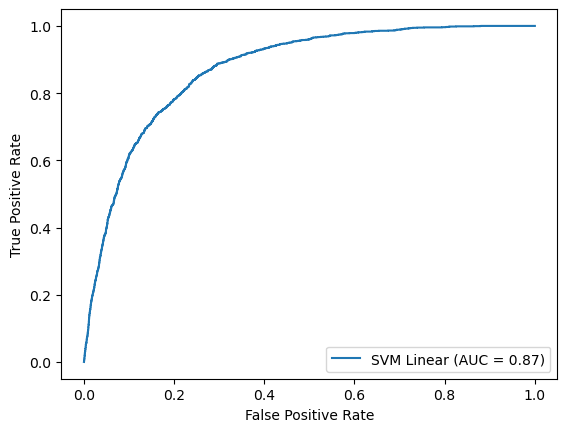

In [26]:
# Training SVM
# Finding Accuracy, AUC, False positive rate, True positive rate, confusion matrix and classification report
# get best parameters for retraining

pred = svc_gridcv_linear.predict(X_test)
predT = svc_gridcv_linear.predict(X_train)

accSVM = accuracy_score(y_test, pred)
accSVM_train = accuracy_score(y_train, predT)
recallSVM = recall_score(y_test, pred)

clf = CalibratedClassifierCV(svc_gridcv_linear) 
clf.fit(X_train, y_train)
y_pred_prob = clf.predict_proba(X_test)
aucScoreSVM = roc_auc_score(y_test,  y_pred_prob[:,1])
fprSVM, tprSVM, thresholds = roc_curve(y_test, y_pred_prob[:,1] )

print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

print("AUC score for Linear SVM is ",aucScoreSVM)
print("Test Accuracy score for Linear SVM is ", accSVM)
print("Train Accuracy score for Linear SVM is ", accSVM_train)
print("Test Recall score for Linear SVM is ",recall_score(y_test, pred))
print("Train Recall score for Linear SVM is ", recallSVM)
print("Best parameters for SVM are ",svc_gridcv_linear.best_params_)

display = RocCurveDisplay(fpr=fprSVM, tpr=tprSVM, roc_auc=aucScoreSVM,
                                 estimator_name='SVM Linear')
display.plot()
plt.show()

In [27]:
svc_other = Pipeline([
    ('transform', transformer),
    ('svcc', SVC(random_state=random_state))])
params_svc_kernel =[
    {'svcc__C':[1,10],'svcc__kernel':['rbf'], 'svcc__gamma':[0.01,0.5]},
    {'svcc__C':[1,10],'svcc__kernel': ['poly'], 'svcc__degree':[2,3]}   
]
svc_gridcv_other = GridSearchCV(estimator=svc_other, param_grid=params_svc_kernel, scoring='accuracy', cv=2)
svc_gridcv_other.fit(X_train,y_train)


GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('transform',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('standardscaler',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'balance',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinalencoder',
                                                                         OrdinalEncoder(),
                                                                         ['job_replaced',
                                                                          'marital',
                                                                          'education']),
                                                                        ('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['default',
                                                                          'housing',
                                                                          'loan'])])),
                                       ('svcc', SVC(random_state=42))]),
             param_grid=[{'svcc__C': [1, 10], 'svcc__gamma': [0.01, 0.5],
                          'svcc__kernel': ['rbf']},
                         {'svcc__C': [1, 10], 'svcc__degree': [2, 3],
                          'svcc__kernel': ['poly']}],
             scoring='accuracy')

[[11804   162]
 [ 1328   270]]
              precision    recall  f1-score   support

           0       0.90      0.99      0.94     11966
           1       0.62      0.17      0.27      1598

    accuracy                           0.89     13564
   macro avg       0.76      0.58      0.60     13564
weighted avg       0.87      0.89      0.86     13564

AUC score for Other SVM is  0.8727336443661713
Test Accuracy score for Other SVM is  0.8901503981126512
Train Accuracy score for Other SVM is  0.8972098461149556
Test Recall score for Other SVM is  0.16896120150187735
Train Recall score for Other SVM is  0.20130046057978868
Best parameters for Other SVM are  {'svcc__C': 10, 'svcc__gamma': 0.01, 'svcc__kernel': 'rbf'}


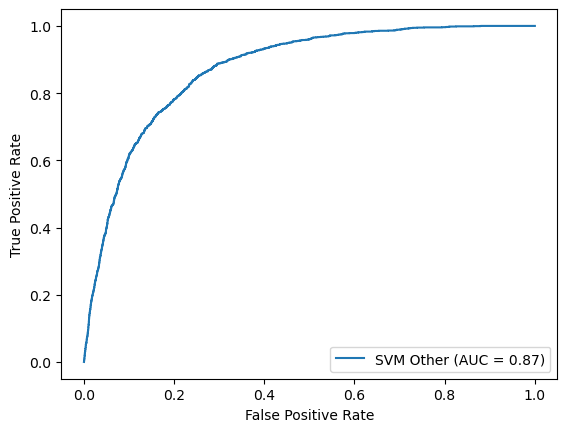

In [28]:
pred = svc_gridcv_other.predict(X_test)
predT = svc_gridcv_other.predict(X_train)

accOtherSVM_test = accuracy_score(y_test, pred)
accOtherSVM_train = accuracy_score(y_train, predT)
recallOtherSVM = recall_score(y_test, pred)

clf = CalibratedClassifierCV(svc_gridcv_linear) 
clf.fit(X_train, y_train)
y_pred_prob = clf.predict_proba(X_test)
aucScoreOtherSVM = roc_auc_score(y_test,  y_pred_prob[:,1])
fprOtherSVM, tprOtherSVM, thresholds = roc_curve(y_test, y_pred_prob[:,1])

print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))
print("AUC score for Other SVM is ",aucScoreOtherSVM)
print("Test Accuracy score for Other SVM is ",accOtherSVM_test)
print("Train Accuracy score for Other SVM is ",accOtherSVM_train)
print("Test Recall score for Other SVM is ",recallOtherSVM)
print("Train Recall score for Other SVM is ",recall_score(y_train, predT))
print("Best parameters for Other SVM are ",svc_gridcv_other.best_params_)


display = RocCurveDisplay(fpr=fprOtherSVM, tpr=tprOtherSVM, roc_auc=aucScoreOtherSVM,
                                 estimator_name='SVM Other')
display.plot()
plt.show()

#### KNN

In [29]:
knn = Pipeline([
    ('transform', transformer),
    ('knnc',KNeighborsClassifier())])
params_knn = {
    'knnc__n_neighbors' : [i for i in range(1,101,5)]
}
knn_gridcv = GridSearchCV(estimator=knn, param_grid=params_knn, scoring='accuracy', cv=cv)
knn_gridcv.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('transform',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('standardscaler',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'balance',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinalencoder',
                                                                         OrdinalEncoder(),
                                                                         ['job_replaced',
                                                                          'marital',
                                                                          'education']),
                                                                        ('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['default',
                                                                          'housing',
                                                                          'loan'])])),
                                       ('knnc', KNeighborsClassifier())]),
             param_grid={'knnc__n_neighbors': [1, 6, 11, 16, 21, 26, 31, 36, 41,
                                               46, 51, 56, 61, 66, 71, 76, 81,
                                               86, 91, 96]},
             scoring='accuracy')

[[11696   270]
 [ 1178   420]]
              precision    recall  f1-score   support

           0       0.91      0.98      0.94     11966
           1       0.61      0.26      0.37      1598

    accuracy                           0.89     13564
   macro avg       0.76      0.62      0.65     13564
weighted avg       0.87      0.89      0.87     13564

AUC score for KNN is  0.8701189404606334
Test Accuracy score for KNN is  0.893246829843704
Train Accuracy score for KNN is  0.9058994533447088
Test Recall score for KNN is  0.26282853566958697
Train Recall score for KNN is  0.3251151449471688
Best parameters for KNN are  {'knnc__n_neighbors': 11}


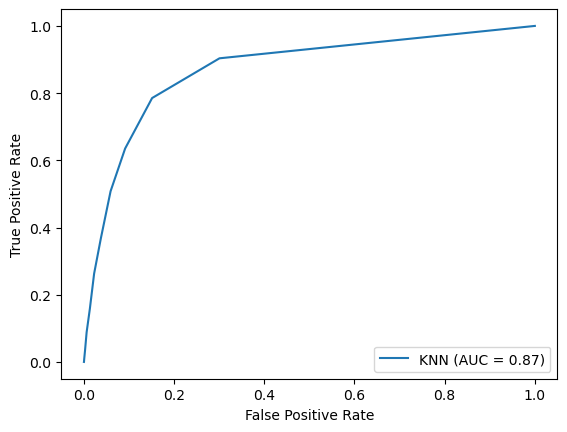

In [30]:
# TRaining KNN agaib for best value of K
# Finding Accuracy, AUC, False positive rate, True positive rate, confusion matrix and classificatio report

pred = knn_gridcv.predict(X_test)
predT = knn_gridcv.predict(X_train)

accKNN = accuracy_score(y_test, pred)
accKNN_train = accuracy_score(y_train, predT)
recallKNN = recall_score(y_test, pred)

y_pred_prob = knn_gridcv.predict_proba(X_test)
aucScoreKNN = roc_auc_score(y_test,  y_pred_prob[:,1])
fprKNN, tprKNN, thresholds = roc_curve(y_test, y_pred_prob[:,1] )

print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

print("AUC score for KNN is ",aucScoreKNN)
print("Test Accuracy score for KNN is ", accKNN)
print("Train Accuracy score for KNN is ", accKNN_train)
print("Test Recall score for KNN is ", recallKNN)
print("Train Recall score for KNN is ",recall_score(y_train, predT))
print("Best parameters for KNN are ", knn_gridcv.best_params_)


display = RocCurveDisplay(fpr=fprKNN, tpr=tprKNN, roc_auc=aucScoreKNN,
                                 estimator_name='KNN')
display.plot()
plt.show()

Notes:

KNN gives accuracy of  which is not very good
There is not much difference between train and test accuracy so its not overfitting or underfitting
Recall is  which is not very good

#### Decision Trees

In [31]:
#DecisionTree
dt = Pipeline([
    ('transform', transformer),
    ('dtree',DecisionTreeClassifier())])
params_dt = {
    'dtree__criterion' : ['gini', 'entropy'],
    'dtree__max_depth' : [1,2,4,8,10,12,16]
}
dt_gridcv = GridSearchCV(dt, param_grid=params_dt, cv=cv)
dt_gridcv.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('transform',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('standardscaler',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'balance',
                                                                          'duration',
                                                                          'campaign',
                                                                          'pdays',
                                                                          'previous']),
                                                                        ('ordinalencoder',
                                                                         OrdinalEncoder(),
                                                                         ['job_replaced',
                                                                          'marital',
                                                                          'education']),
                                                                        ('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['default',
                                                                          'housing',
                                                                          'loan'])])),
                                       ('dtree', DecisionTreeClassifier())]),
             param_grid={'dtree__criterion': ['gini', 'entropy'],
                         'dtree__max_depth': [1, 2, 4, 8, 10, 12, 16]})

### Examine the feature importance in Decision Tree Classifier

Text(0.5, 1.0, 'Feature Importance of Decision Tree Classifier')

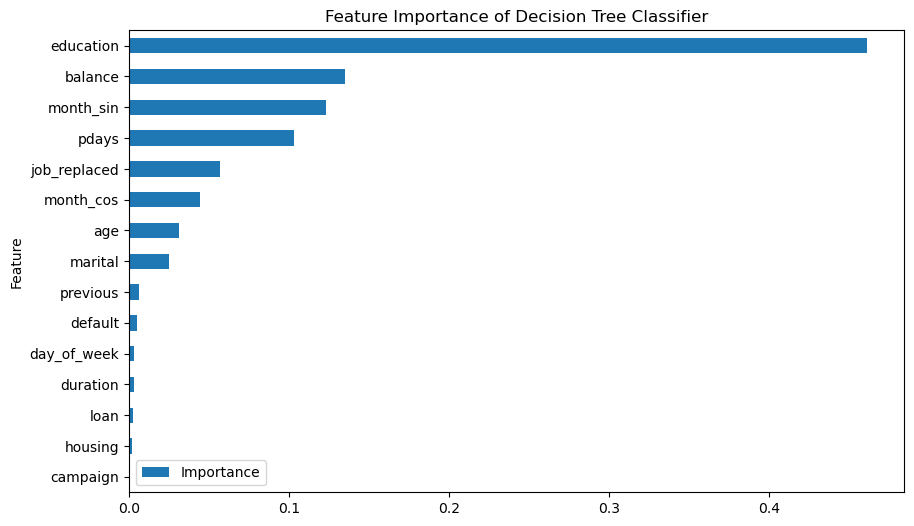

In [51]:
dt_features = dt_gridcv.best_estimator_.named_steps.dtree.feature_importances_

feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(dt_features)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))
plt.title("Feature Importance of Decision Tree Classifier")

[[11372   594]
 [  848   750]]
              precision    recall  f1-score   support

           0       0.93      0.95      0.94     11966
           1       0.56      0.47      0.51      1598

    accuracy                           0.89     13564
   macro avg       0.74      0.71      0.73     13564
weighted avg       0.89      0.89      0.89     13564

AUC score for Decision Tree is  0.8823207787103091
Test Accuracy score for Decision Tree is  0.8936891772338543
Train Accuracy score for Decision Tree is  0.9092173033778873
Test Recall score for Decision Tree is  0.4693366708385482
Train Recall score for Decision Tree is  0.5345434841506367


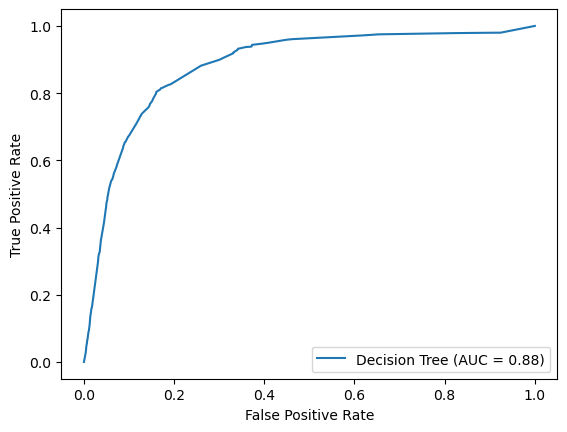

In [50]:

pred = dt_gridcv.predict(X_test)
predT = dt_gridcv.predict(X_train)

accDT = accuracy_score(y_test, pred)
accDT_train = accuracy_score(y_train, predT)
recallDT = recall_score(y_test, pred)

y_pred_prob = dt_gridcv.predict_proba(X_test)
aucScoreDtree= roc_auc_score(y_test,  y_pred_prob[:,1])
fprDtree, tprDtree, thresholds = roc_curve(y_test, y_pred_prob[:,1] )

print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

print("AUC score for Decision Tree is ",aucScoreDtree)
print("Test Accuracy score for Decision Tree is ", accDT)
print("Train Accuracy score for Decision Tree is ", accDT_train)
print("Test Recall score for Decision Tree is ", recallDT)
print("Train Recall score for Decision Tree is ",recall_score(y_train, predT))

display = RocCurveDisplay(fpr=fprDtree, tpr=tprDtree, roc_auc=aucScoreDtree,
                                 estimator_name='Decision Tree')
display.plot()
plt.show()

## Findings

The target variable is highly imbalanced with 88% being 0(customers who did not sign up for the deposit). I used cross validation to distribute the classes evenly. GridSearchCV uses kfold for classification estimators. The most explainable models are those created by the Linear SVM classifier, Logistic regression classifier, and the Decision tree classifier where you can use coefficients or the feature importance to determine which features contribute the most strongly to the models' predictions. 
- For the Decision Tree classifier , "education" and "balance" are the two most important features. 
- For the Linear SVM classifier and a Logistic regression classifier , the two most important features are "education" and "pdays".

I have use Accuracy scores, Recall, and AUC Scores. Test Accuracy is about the same at 0.89 for all the classifiers

Why Recall? This is a marketing problem and I want to focus on optimizing by having more conversations with potential leads which ultimately converts (True Positives). I do not want to risk incorrectly assuming the customer will not convert. The Recall is highest for the Decision Tree (0.47), followed by KNN (0.26). Cross Validation scores are about 0.89 for all classifiers. Mean Fit time is the worst for an SVM classifier. The Decision Tree and the KNN performs well for fit times. 

Recall = TP / TP + FN

Finding more clients which have higher chances of saying yes to subscription of term deposit , will save a lot of manhours and efforts. Predicting as many positives as possible out of actual positives from dataset is the goal here, recall has been chosen as one of the performance matrices along with accuracy and AUC score.

The Decision Tree classifier is my choice of classification algorithm because of a better Recall value and good accuracy score and fit times. Because the training and test scores are similar, the models is not overfitted. 

<b>COMPARISON OF CLASSIFIERS</b>

|Classifier|Pros|Cons|
|---|---|---|
|Logistic Regression|Simple, Fast, Interpretable, scalable by using stochastic gradient descent|Linearity Assumption, Overfitting Risk when the number of features > data samples, Lack of Automatic Feature Interaction, Sensitivity to Outliers|
|Decision Trees|Capturing Complex Relationships, Easy Interpretation and Visualization|Overfitting and instability|
|KNN|Easy to Grasp ,Eliminates Training Phase,Versatility|Increasing Computational Demands, Sensitivity to Data Density|
|SVM|Suitable for Complex Data with high number of dimensions, Flexibility with both linear and non-linear data through the Control Overfitting with regularization parameters|Memory-intensive, particularly when dealing with large datasets. Sensitivity to Noisy Data|


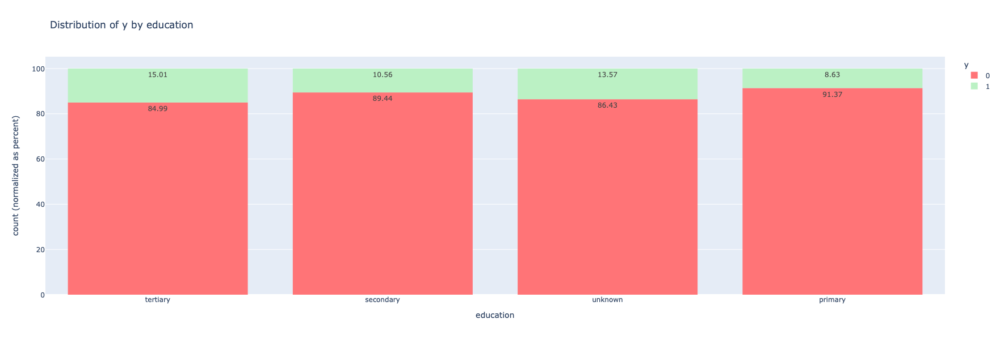

In [63]:
fig7 = px.histogram(bank_marketing_df,
                x="education", 
                color="y", 
                title=f'Distribution of y by education', 
                color_discrete_map={0:'#FF7477',1:'#BBF1C4'},
                text_auto=True, 
                barnorm="percent", width=800, height=600)
fig7.update_traces(texttemplate='%{y:.2f}')
fig7.show()

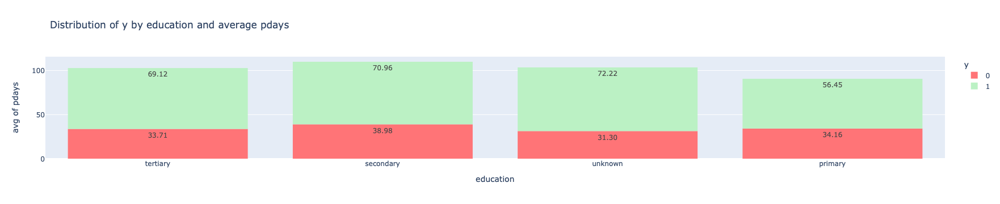

In [81]:
fig8 = px.histogram(bank_marketing_df,
                y="pdays", 
                x="education",
                color="y", 
                title=f'Distribution of y by education and average pdays', histfunc='avg',
                color_discrete_map={0:'#FF7477',1:'#BBF1C4'})
fig8.update_traces(texttemplate='%{y:.2f}')
fig8.show()

classification_models = []
df_scores_classifiers = pd.DataFrame()
fit_times = []
accuracy_scores_train = []
accuracy_scores_test = []
recall_scores = []
auc_scores = []

classification_models.append(('LogisticRegression',lr_gridcv.best_estimator_))
accuracy_scores_test.append(accLR)
accuracy_scores_train.append(accLR_train)
recall_scores.append(recallLR)
fit_times.append(np.round(np.mean(lr_gridcv.cv_results_['mean_fit_time']),2))
auc_scores.append(aucScoreLR)

classification_models.append(('LinearSVC', svc_gridcv_linear.best_estimator_))
accuracy_scores_test.append(accSVM)
accuracy_scores_train.append(accSVM_train)
recall_scores.append(recallSVM)
fit_times.append(np.round(np.mean(svc_gridcv_linear.cv_results_['mean_fit_time']),2))
auc_scores.append(aucScoreSVM)

classification_models.append(('OtherSVC', svc_gridcv_other.best_estimator_))
accuracy_scores_test.append(accOtherSVM_test)
accuracy_scores_train.append(accOtherSVM_train)
recall_scores.append(recallOtherSVM)
fit_times.append(np.round(np.mean(svc_gridcv_other.cv_results_['mean_fit_time']),2))
auc_scores.append(aucScoreOtherSVM)

classification_models.append(('KNN', knn_gridcv.best_estimator_))
accuracy_scores_test.append(accKNN)
accuracy_scores_train.append(accKNN_train)
recall_scores.append(recallKNN)
fit_times.append(np.round(np.mean(knn_gridcv.cv_results_['mean_fit_time']),2))
auc_scores.append(aucScoreKNN)

classification_models.append(('DecisionTrees', dt_gridcv.best_estimator_))
accuracy_scores_test.append(accDT)
accuracy_scores_train.append(accDT_train)
recall_scores.append(recallDT)
fit_times.append(np.round(np.mean(dt_gridcv.cv_results_['mean_fit_time']),2))
auc_scores.append(aucScoreDtree)

In [34]:
for name, model in classification_models:
    model_scores = cross_val_score(model, X_train,y_train, scoring='accuracy', cv=cv, n_jobs=-1)
    df_scores_classifiers[name] = model_scores

In [35]:
df_scores_classifiers

,LogisticRegression,LinearSVC,OtherSVC,KNN,DecisionTrees
0,0.885782,0.886098,0.890047,0.889731,0.892891
1,0.887836,0.887678,0.892101,0.891469,0.888784
2,0.891768,0.891926,0.893980,0.894296,0.899036
3,0.894296,0.890978,0.894138,0.892242,0.892874
4,0.893980,0.890820,0.891768,0.895244,0.899036


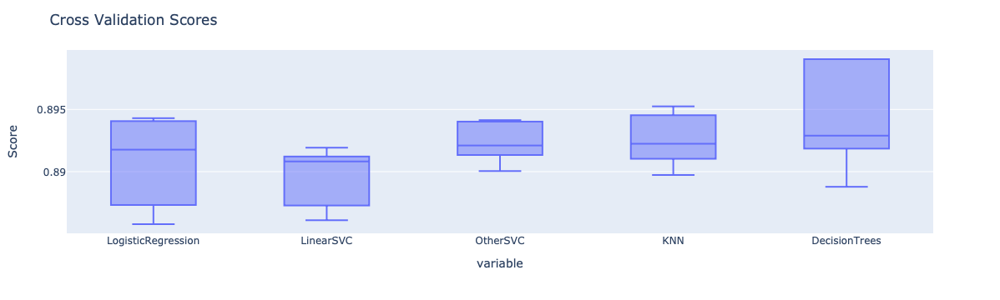

In [36]:
fig3=px.box(data_frame=df_scores_classifiers)
fig3.update_layout( title="Cross Validation Scores", yaxis_title="Score")
#fig3.write_image("boxplot_cv.jpg")
fig3.show()

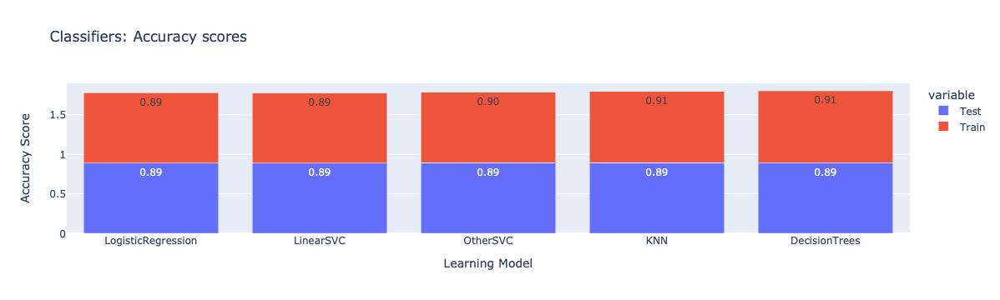

In [37]:
strong_learners_models = [model_name for model_name, model in classification_models]

fig4 = px.bar(x=strong_learners_models, y = [accuracy_scores_test,accuracy_scores_train], 
        title='Classifiers: Accuracy scores', text=accuracy_scores_test)
newnames = {'wide_variable_0':'Test', 'wide_variable_1': 'Train'}
fig4.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     ))
fig4.update_layout( xaxis_title="Learning Model",
    yaxis_title="Accuracy Score")
fig4.update_traces(texttemplate='%{y:.2f}')
fig4.show()

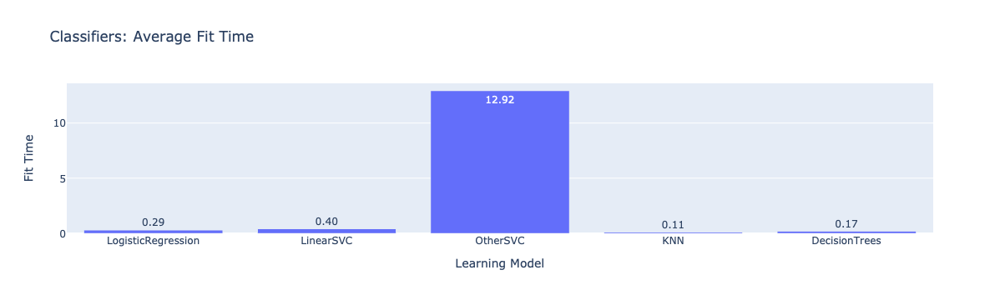

In [38]:
fig5 = px.bar(x=strong_learners_models, y = fit_times, 
        title='Classifiers: Average Fit Time', text=fit_times)

fig5.update_layout( xaxis_title="Learning Model",
    yaxis_title="Fit Time")
fig5.update_traces(texttemplate='%{y:.2f}')
fig5.show()

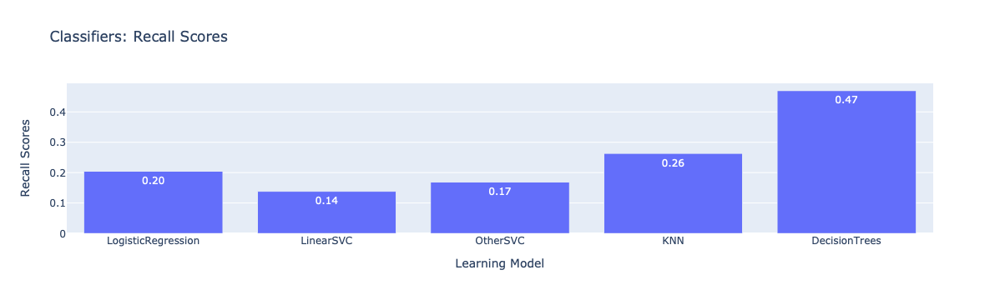

In [39]:
fig6 = px.bar(x=strong_learners_models, y = recall_scores, 
        title='Classifiers: Recall Scores', text=recall_scores)

fig6.update_layout( xaxis_title="Learning Model",
    yaxis_title="Recall Scores")
fig6.update_traces(texttemplate='%{y:.2f}')
fig6.show()

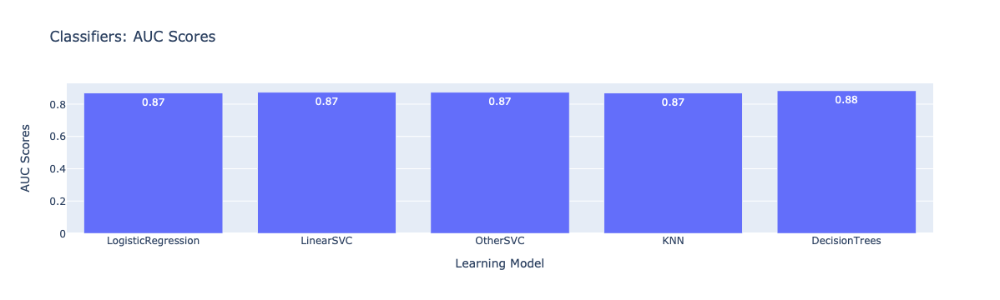

In [40]:
fig6 = px.bar(x=strong_learners_models, y = auc_scores, 
        title='Classifiers: AUC Scores', text=recall_scores)

fig6.update_layout( xaxis_title="Learning Model",
    yaxis_title="AUC Scores")
fig6.update_traces(texttemplate='%{y:.2f}')
fig6.show()

## Next Steps

Use SMOTE to see if the class imbalance situation can be improved. Use the month_sin and month_cos to examine if there is seasonality correlations on which the campaigns should be timed.